<p align = "center" draggable=”false” ><img src="https://user-images.githubusercontent.com/37101144/161836199-fdb0219d-0361-4988-bf26-48b0fad160a3.png" 
     width="200px"
     height="auto"/>
</p>

# Hate Speech Detector

Today you are a machine learning engineer, a member of the Birdwatch at Twitter. 

The objective of this task is to detect hate speech in tweets. For the sake of simplicity, a tweet contains hate speech if it has a racist or sexist sentiment associated with it. In other words, we need to classify racist or sexist tweets from other tweets.

A labelled dataset of 31,962 tweets (late 2017 to early 2018) is provided in the form of a compressed csv file with each line storing a tweet id, its label, and the tweet. Label '1' denotes the tweet is racist/sexist while label '0' denotes the tweet is not racist/sexist.

We will first approach the problem in a traditional approach: clean the raw text using simple regex (regular expression), extract features, build a naive Bayes models to classify tweets; then we build a deep learning model and explain our deep learning model with LIME.

## 📚 Learning Objectives

By the end of this lesson, you will be able to:

- Understand the basic concepts in natural language processing (NLP)
- Perform basic NLP tasks on text, e.g., tweets
- Build a naive Bayes classifier to detect hate speech 
- Build a bidirectional long short-term memory (BiLSTM) to detect hate speech
- Visualize embeddings with Tensorboard embedding projector
- Explain models with LIME

# Task I: Data Preprocessing


1. Install dependencies.

    Most modules are pre-installed in Colab, however, we need to update `gensim` to its recent version and install `lime`.

In [1]:
!pip install -U -q gensim==4.2.0 lime

2. Connect Colab to your local Google Drive.

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


3. Use `pandas.read_csv` to load the tweets in `tweets.csv.gz` and save the `pd.DataFrame` into `raw`. Make sure the path points to where the data is located in your Google Drive. 

In [3]:
import pandas as pd
raw = pd.read_csv('/content/tweets.csv.gz', compression='gzip')

In [4]:
print(raw.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 31962 entries, 0 to 31961
Data columns (total 3 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   id      31962 non-null  int64 
 1   label   31962 non-null  int64 
 2   tweet   31962 non-null  object
dtypes: int64(2), object(1)
memory usage: 749.2+ KB
None


4. Sample 5 random tweets from the dataset for each label and display `label` and `tweet` columns. 
Hint: one option is to use `sample()` followed by `groupby`. 

In [5]:
# Colab includes an extension that renders pandas dataframes into interactive displays that can be filtered, sorted, and explored dynamically.
from google.colab import data_table
data_table.enable_dataframe_formatter() 

raw.groupby("label")['label', 'tweet'].sample(5, random_state=0)

<ipython-input-5-f0eb5a1c7ba3>:5: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.
  raw.groupby("label")['label', 'tweet'].sample(5, random_state=0)


,label,tweet
21574,0,busy day tomorrow! yay! #listings #letsgo #rea...
4291,0,ready to up-level and sta your dream coaching ...
27957,0,@user @user it sure has going to be amazing ...
24463,0,i'm really super to watch #theconjuring2 tod...
11875,0,"blown away right now... 112,000 for @user yest..."
15583,1,every lactation consultant i've ever met has b...
11331,1,@user outraged by the emoji update. how dare t...
10568,1,techjunkiejh:'alt-right' site plans a 'fake bl...
9519,1,confessions of former neo-#confederate. #aud...
12305,1,@user i agree.


5. The tweets are in English and all words should be already in lowercase. 
Now calculate the number of characters in each tweet and assign the values to a new column `len_tweet` in `raw`. 

In [6]:
raw['len_tweet'] = raw.tweet.apply(lambda x: len(x))

6. What are the summary statistics of `len_tweet` for each label? 
Hint: use `groupby` and `describe`. 

In [7]:
pd.set_option("display.precision", 1)

raw.groupby("label")['len_tweet'].describe()

,count,mean,std,min,25%,50%,75%,max
label,,,,,,,,
0,29720.0,84.3,29.6,11.0,62.0,88.0,107.0,274.0
1,2242.0,90.2,27.4,12.0,69.0,96.0,111.0,152.0


Note we have an imbalanced dataset: the ratio of non-hate speech to hate speech is roughly 13:1. 

7. Clean the tweets. 

    We use `re` to perform basic text manipulations. 
    Specically, remove anonymized user handle, remove numbers and special characters except hashtags.

In [8]:
import re

8. Remove user handles from the text in `tweet`, or anything directly following the symbols `@`, and save the resulting tweets to a new column `tidy_tweet` in `raw`. 
    
    Hint: you can use `re.sub` on individual text and [`apply`](https://pandas.pydata.org/docs/reference/api/pandas.DataFrame.apply.html) a simple lambda function for the series `raw['tweet']`.

In [9]:
raw['tidy_tweet'] = raw.tweet.apply(lambda x: re.sub(r'@[\w-]+', '', x))
raw.sample(5, random_state=203)

,id,label,tweet,len_tweet,tidy_tweet
790,791,1,@user and you keep telling that only aryans ar...,109,and you keep telling that only aryans are all...
21928,21929,0,@user what makes you ?,25,what makes you ?
25642,25643,0,"â #nzd/usd extends rbnz-led rally, hits fre...",101,"â #nzd/usd extends rbnz-led rally, hits fre..."
20436,20437,0,i'm on a mission to ride all of the animals! ...,91,i'm on a mission to ride all of the animals! ...
22552,22553,0,the color of a human skin matters a lot to the...,88,the color of a human skin matters a lot to the...


9. Remove non-alphabetic characters yet keep symbols `#` from `tidy_tweet` and save the result in `tidy_tweet`. 
In other words, keep all 26 letters and `#`.

    Note: in some applications, punctuations, emojis, or whether the word is in all caps can be of use. 
    You shall decide whether to extract such features for the application and perform error analysis to gain insight. 

In [10]:
 raw.tidy_tweet.apply(lambda x: re.sub(r"[^a-z# ]", '', x))

0          when a father is dysfunctional and is so sel...
1          thanks for #lyft credit i cant use cause the...
2                                      bihday your majesty
3        #model   i love u take with u all the time in ...
4                    factsguide society now    #motivation
                               ...                        
31957                                 ate  isz that youuu 
31958      to see nina turner on the airwaves trying to...
31959    listening to sad songs on a monday morning otw...
31960     #sikh #temple vandalised in in #calgary #wso ...
31961                          thank you  for you follow  
Name: tidy_tweet, Length: 31962, dtype: object

In [11]:
raw['tidy_tweet'] = raw.tidy_tweet.apply(lambda x: re.sub(r"[^a-z# ]", '', x))
raw.sample(5, random_state=203)

,id,label,tweet,len_tweet,tidy_tweet
790,791,1,@user and you keep telling that only aryans ar...,109,and you keep telling that only aryans are all...
21928,21929,0,@user what makes you ?,25,what makes you
25642,25643,0,"â #nzd/usd extends rbnz-led rally, hits fre...",101,#nzdusd extends rbnzled rally hits fresh yea...
20436,20437,0,i'm on a mission to ride all of the animals! ...,91,im on a mission to ride all of the animals #...
22552,22553,0,the color of a human skin matters a lot to the...,88,the color of a human skin matters a lot to the...


10. Remove words that is shorter than 4 characters from the processed tweets.

    For example, 
      
    `i m on a mission to ride all of the animals #teamchanlv #vegas #lasvegas #funtimes`
      
    will be reduced to 
      
    `mission ride animals #teamchanlv #vegas #lasvegas #funtimes`


In [12]:
tweet_string = "i m on a mission to ride all of the animals #teamchanlv #vegas #lasvegas #funtimes"
" ".join([ele for ele in re.split(" ",tweet_string) if len(ele)>=4])

'mission ride animals #teamchanlv #vegas #lasvegas #funtimes'

In [13]:
raw['tidy_tweet'] = raw.tidy_tweet.apply(lambda tweet_string: " ".join([ele for ele in re.split(" ",tweet_string) if len(ele)>=4]))
raw.sample(5, random_state=203)

,id,label,tweet,len_tweet,tidy_tweet
790,791,1,@user and you keep telling that only aryans ar...,109,keep telling that only aryans allowed rape wom...
21928,21929,0,@user what makes you ?,25,what makes
25642,25643,0,"â #nzd/usd extends rbnz-led rally, hits fre...",101,#nzdusd extends rbnzled rally hits fresh year ...
20436,20437,0,i'm on a mission to ride all of the animals! ...,91,mission ride animals #teamchanlv #vegas #lasve...
22552,22553,0,the color of a human skin matters a lot to the...,88,color human skin matters system when comes jud...


11. Remove stopwords and perform text normalization. 
    
    We will use `stopwords` collection and `SnowballStemmer` in `nltk` for this task. Before doing so, we need to tokenize the tweets. 
    Tokens are individual terms or words, and tokenization is simply to split a string of text into tokens. 
    You can use [`str.split()`](https://docs.python.org/3/library/stdtypes.html#str.split) on individual text and [`apply`](https://pandas.pydata.org/docs/reference/api/pandas.DataFrame.apply.html) a simple lambda function for the series `raw['tidy_tweet']` and save the result into `tokenized_tweet`. 
    
    Check out some methods for the built-in type `str` [here](https://docs.python.org/3/library/stdtypes.html#string-methods).

In [14]:
from nltk.stem.snowball import SnowballStemmer
snow_stemmer = SnowballStemmer(language='english')

tokenized_tweet = raw.tidy_tweet.apply(lambda tweet_string: " ".join([snow_stemmer.stem(w) for w in re.split(" ",tweet_string)]))
tokenized_tweet.head()

0    when father dysfunct selfish drag kid into dys...
1    thank #lyft credit cant caus they dont offer w...
2                                  bihday your majesti
3                           #model love take with time
4                             factsguid societi #motiv
Name: tidy_tweet, dtype: object

12. Extract stop words and remove them from the tokens.

    Note: depending on the task / industry, it is highly recommended that one curate custom stop words. 

In [15]:
import nltk
nltk.download('stopwords')
from nltk.corpus import stopwords
stop_words = stopwords.words('english')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [16]:
tokenized_tweet = tokenized_tweet.apply(lambda tweet_string: " ".join([w for w in re.split(" ",tweet_string) if w not in stop_words]))

In [17]:
assert any(word in tokenized_tweet for word in stop_words) == False

13. Create a new instance of a language specific [`SnowballStemmer`](https://www.nltk.org/api/nltk.stem.snowball.html), set the `language` to be "english"; see [how to](https://www.nltk.org/howto/stem.html). 

In [18]:
from nltk.stem.snowball import SnowballStemmer
stemmer = SnowballStemmer(language='english')

In [19]:
tokenized_tweet = tokenized_tweet.apply(lambda x: [stemmer.stem(i) for i in x]) 
tokenized_tweet.head()

0    [f, a, t, h, e, r,  , d, y, s, f, u, n, c, t, ...
1    [t, h, a, n, k,  , #, l, y, f, t,  , c, r, e, ...
2           [b, i, h, d, a, y,  , m, a, j, e, s, t, i]
3    [#, m, o, d, e, l,  , l, o, v, e,  , t, a, k, ...
4    [f, a, c, t, s, g, u, i, d,  , s, o, c, i, e, ...
Name: tidy_tweet, dtype: object

14. Lastly, let's stitch these tokens in `tokenized_tweet` back together and save them in `raw['tidy_tweet']`. 
Use [`str.join()`](https://docs.python.org/3/library/stdtypes.html#str.join) and `apply`.

In [20]:
raw['tidy_tweet'] = tokenized_tweet.apply(lambda x: "".join([stemmer.stem(i) for i in x]))

# Task 2. Wordcloud and Hashtag

In this task, we want to gain a general idea of what the common words were and how hashtags were used in tweets. 
We will create wordclouds and extract the top hashtags used in each label. 

1. Before doing so, out of caution of possible data leakage, split the `raw['tidy_tweet']` into training and test datasets in a stratified fashion, set the test size at .25 and random state as 42.
    
    Save the results into `X_train`, `X_test`, `y_train`, and `y_test`.

In [21]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(
    raw['tidy_tweet'], raw.label, 
    test_size=0.25, random_state=42, stratify=raw.label)

In [22]:
assert X_train.shape == y_train.shape == (23971, )
assert X_test.shape == y_test.shape == (7991,)

2. A word cloud is a cluster of words depicted in different sizes. 
The bigger the word appears, the more often it appears in the given text. 
It can offer an easy visual presentation to reveal the theme of a topic. 

    Function `plot_wordcloud` is provided to plot 50 most frequent words from the given text in the shape of twitter's logo. 
    You may need to replace the image path accordingly.

In [23]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image

def plot_wordcloud(text:str) -> None:
    '''
    Plot a wordcloud of top 50 words from the input text
    masked by twitter logo
    '''
    mask = np.array(Image.open('/content/twitter-mask.png')) # REPLACE w/ YOUR FILE PATH
    wordcloud = WordCloud( 
        background_color='white', 
        random_state=42,
        max_words=50, 
        max_font_size=80, 
        mask = mask).generate(text)
    plt.figure(figsize=(10,10))
    plt.imshow(wordcloud, interpolation="bilinear")
    plt.axis("off")
    plt.show()

3. Visualize the wordcloud. 

    The function expects one long string. 
    Stitch all tidy tweets from training set and save the single string to `all_words`, then visualize the wordcloud for all the words.

In [24]:
all_words = ' '.join([text for text in raw['tidy_tweet']])

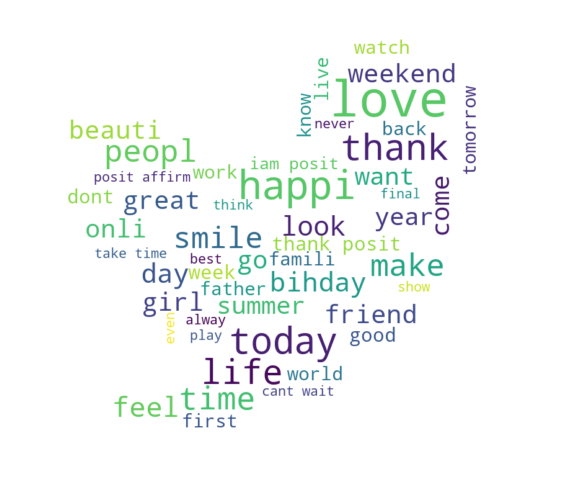

In [25]:
plot_wordcloud(all_words)

4. Visualize the wordcloud just for the text from the tweets identified as hate speech. 

    Similarly, you need to stitch all the tidy tweets in training set that were identified as hate speech. 
    Save the long string to `negative_words`.

In [26]:
negative_words = ' '.join([text for text in raw['tidy_tweet'][raw.label == 1]])

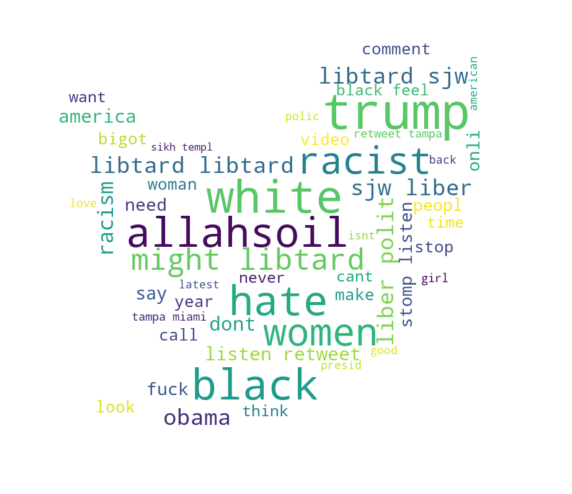

In [27]:
plot_wordcloud(negative_words)

5. Hashtag is a feature for tweets and we would like to inspect if hashtags provide information for our classification task. 

    Function `hashtag_extract` is provided to extract hastags from an iterable (list or series) and return the hashtags in a list. 

In [28]:
def hashtag_extract(x) -> list:
    """
    extract hastags from an iterable (list or series) and 
    return the hashtags in a list.
    """
    hashtags = []
    # Loop over the words in the tweet
    for i in x:
        ht = re.findall(r"#(\w+)", i)
        hashtags.append(ht)
    return hashtags

6. Extract hashtags from non-hate speech tweets.

In [29]:
HT_regular = hashtag_extract(raw['tidy_tweet'][raw.label == 0])

In [30]:
assert type(HT_regular) == list
assert type(HT_regular[0]) == list # nested list

7. Now extract hashtags from hate speech tweets.

In [31]:
HT_negative = hashtag_extract(raw['tidy_tweet'][raw.label == 1])

8. Both `HT_regular` and `HT_negative` are nested lists, so use the following trick to unnest both lists.

In [32]:
HT_regular = sum(HT_regular,[])
HT_negative = sum(HT_negative,[])

In [33]:
assert type(HT_regular) == type(HT_negative) == list
assert type(HT_regular[0]) == type(HT_negative[0]) == str

9. Complete the function `top_hashtags` below to take a list of hashtags and return the top `n` hashtag keyword and its frequncy. 

In [34]:
from typing import List, Tuple
from collections import Counter
def top_hashtags(hashtags:List[str], n=10) -> List[Tuple[str, int]]:
    ''' Function to return the top n hashtags '''
    return Counter(hashtags).most_common(n)

1. Apply the function to the hashtag lists from the non-hate speech tweets and the hate speech tweets.

In [35]:
top_hashtags(HT_regular)

[('love', 1638),
 ('posit', 917),
 ('smile', 674),
 ('healthi', 572),
 ('thank', 534),
 ('fun', 461),
 ('affirm', 423),
 ('life', 422),
 ('summer', 385),
 ('model', 375)]

In [36]:
top_hashtags(HT_negative)

[('trump', 136),
 ('polit', 95),
 ('allahsoil', 92),
 ('liber', 81),
 ('libtard', 77),
 ('sjw', 74),
 ('retweet', 63),
 ('black', 46),
 ('miami', 46),
 ('hate', 37)]

10. DISCUSS: are these hashtags making sense? should we include them as features or should we strip the # before tokenizing (that is, treat "#love" the same as "love")? why and why not?
          I do not trust this compilation of cherry-picked tweets, labels, etc. and believe hate speech is an extremely complicated task that cannot be solved by filtering hashtags.
          I also believe sensoring speech poses its own threat.
          For this assignment thought I would agree that the hashtags generally make sense for the classifications they belong to.
          Why? Because the top non-hate hashtag have positive sentiment (love) while the hate-tags have some slurs like 'libtard'

# Task 3. Features

Note that almost all the machine learning related Python modules expect numerical presentation of data; thus we need to transform our text first.
We will experiment with bag of words, tf-idf, and word2vec.  

1. Convert the collection of text documents to a matrix of token counts.

    Check the [official documentation](https://scikit-learn.org/stable/modules/generated/sklearn.feature_extraction.text.CountVectorizer.html). 
    
    Create an instance of `CountVectorizer` named `bow_vectorizer`, set `max_features` to be `MAX_FEATURES`.
    Learn the vocabulary dictionary and return document-term matrix and save it to `bow_train`. Use `.fit_transform`. 

In [37]:
from sklearn.feature_extraction.text import CountVectorizer
MAX_FEATURES = 1000


bow_vectorizer = CountVectorizer(max_features=MAX_FEATURES, stop_words='english')
bow_train = bow_vectorizer.fit_transform(X_train)

In [38]:
assert bow_train.shape == (X_train.shape[0], MAX_FEATURES)

2. Print the first three rows from `bow_train`. Hint: `.toarray()`.

In [39]:
bow_test = bow_vectorizer.transform(X_test)

In [40]:
from scipy.sparse.csr import csr_matrix
assert type(bow_train) == csr_matrix

3. Similarly, convert the collection of text documents to a matrix of TF-IDF features.
    
    Create an instance of [`TfidfVectorizer`](https://scikit-learn.org/stable/modules/generated/sklearn.feature_extraction.text.TfidfVectorizer.html#sklearn.feature_extraction.text.TfidfVectorizer) named `tfidf_vectorizer`, set `max_features` to be `MAX_FEATURES`.

    Learn the vocabulary and idf, return document-term matrix and save it to `tfidf_train`. 

In [41]:
from sklearn.feature_extraction.text import TfidfVectorizer

In [42]:
tfidf_vectorizer = TfidfVectorizer(max_features=MAX_FEATURES, stop_words='english')
tfidf_train = tfidf_vectorizer.fit_transform(X_train)

In [43]:
assert type(tfidf_train) == csr_matrix
assert tfidf_train.shape == bow_train.shape == (X_train.shape[0], MAX_FEATURES)

4. Extract word embeddings using Word2Vec. 
We will use [`gensim`](https://radimrehurek.com/gensim/auto_examples/tutorials/run_word2vec.html) for this task. 
    
    The Word2Vec model takes either a list of lists of tokens or an iterable that streams the sentences directly from disk/network. 
    Here, we tokenize the tidy tweets in `X_train` and save the list (`pd.series`) of lists of tokens to `tokenized_tweet`. 

In [44]:
tokenized_tweet = X_train.apply(lambda x: x.split())

In [45]:
assert tokenized_tweet.shape == X_train.shape

In [46]:
tokenized_tweet.head()

1036     [like, spread, peanut, butter, white, bread, #...
2380     [watch, made, america, simpson, interest, went...
31605    [franci, underwood, seen, leav, marseill, #nojok]
23437    [#enjoy, #music, #today, #free, #app, #free, #...
2669     [#juic, experi, #notsobad, #healthyliv, #eatcl...
Name: tidy_tweet, dtype: object

5. Import `Word2Vec` from `gensim.models`; see [doc](https://radimrehurek.com/gensim/models/word2vec.html#gensim.models.word2vec.Word2Vec). 

    Create a skip-gram `Word2Vec` instance named `w2v` that learns on the `tokenized_tweet`, with `vector_size` set at `MAX_FEATURES`, and other parameters are provided. 

In [47]:
from gensim.models import Word2Vec

In [48]:
w2v = Word2Vec(
        tokenized_tweet,
        vector_size=MAX_FEATURES,
        window=5, min_count=2, sg = 1, 
        hs = 0, negative = 10,  workers= 2, 
        seed = 34)

6. Train the skip-gram model, set the epochs at 20.

In [49]:
%%time
w2v.train(tokenized_tweet, total_examples= len(X_train), epochs=20)

CPU times: user 1min 41s, sys: 253 ms, total: 1min 41s
Wall time: 1min 5s


(2763953, 3277280)

7. Let's see how the model performs. 
Specify a word and print out the 10 most similar words from the our tweets in the training set. 
Use [`most_similar`](https://radimrehurek.com/gensim/models/keyedvectors.html#gensim.models.keyedvectors.KeyedVectors.most_similar). 
Hint: print the type of `w2v` and `w2v.wv`.

In [50]:
w2v.wv.most_similar(positive="love")

[('iloveyou', 0.4860939681529999),
 ('rejoic', 0.4838463068008423),
 ('#alreadi', 0.4700779318809509),
 ('nicol', 0.4680950343608856),
 ('grant', 0.45837995409965515),
 ('unborn', 0.45603206753730774),
 ('#mommylif', 0.4522140622138977),
 ('precious', 0.4520535171031952),
 ('candi', 0.4518581032752991),
 ('beaut', 0.4499460458755493)]

8. Discuss: how does w2v calculate the similarities?

        Word2Vec calculates similarities between words by representing them as high-dimensional vectors and measuring the cosine similarity between these vectors.

        The Word2Vec model represents words as dense, real-valued vectors in a high-dimensional space, where each dimension represents a feature or characteristic of the word. The values in each dimension of the vector capture how strongly the corresponding feature is associated with the word. For example, in a two-dimensional space, a vector might represent the word "king" as [0.9, 0.1], while the word "queen" might be [0.8, 0.2].

        To calculate the similarity between two words, Word2Vec calculates the cosine similarity between their corresponding vectors. The cosine similarity measures the cosine of the angle between two vectors, and ranges from -1 (completely dissimilar) to 1 (identical).

        More specifically, to compute the cosine similarity between two vectors, Word2Vec takes the dot product of the two vectors and divides it by the product of their lengths (i.e., the Euclidean norm). The resulting value represents the cosine of the angle between the vectors.

        The similarity score obtained from Word2Vec can be used to identify words that are semantically similar or related, and it has been shown to be effective in a variety of natural language processing applications such as information retrieval, text classification, and machine translation.

9. Discuss: do you think Word2Vec is supervised or unsupervised ML technique?

        Word2Vec is an unsupervised machine learning technique, as it does not require labeled training data or explicit supervision in the form of input-output pairs. Instead, Word2Vec learns the vector representations of words by analyzing large amounts of unlabeled text data, which allows it to capture the underlying semantic and syntactic relationships between words in an unsupervised manner.

        The training process for Word2Vec involves processing a large corpus of text and using a neural network to learn the vector representations of the words in the corpus. The network is trained to predict the context (i.e., the words that surround a given word) or the target word (i.e., the word being predicted from its context) in a sliding window of words. This process is known as either the continuous bag-of-words (CBOW) or skip-gram method.

        The Word2Vec model is therefore unsupervised, in that it does not require explicit supervision or feedback from a human annotator to learn the relationships between words. Instead, it relies on patterns and regularities in the distribution of words in the corpus to learn the vector representations of words, and the resulting representations can be used for a variety of downstream natural language processing tasks.

10. Engineer features. 

    For each tweet, we calculate the average of embeddings (function `word_vector`) and then apply it to every tidy tweet in `X_train` (use function `tokens_to_array`).
    Both functions are provided, inspect the code and save the features in `w2v_train`.

In [51]:
from gensim.models.keyedvectors import KeyedVectors

def word_vector(tokens:list, size:int, keyed_vec:KeyedVectors= w2v.wv):
    vec = np.zeros(size).reshape((1, size))
    count = 0
    for word in tokens:
        try:
            vec += keyed_vec[word].reshape((1, size))
            count += 1
        except KeyError: 
            # handling the case where the token is not in vocabulary        
            continue
    if count != 0:
        vec /= count
    return vec

def tokens_to_array(tokens:list, size:int, keyed_vec:KeyedVectors= w2v.wv):
    array = np.zeros((len(tokens), size))
    for i in range(len(tokens)):
        array[i,:] = word_vector(tokens.iloc[i], size, keyed_vec=keyed_vec)
    return array

In [52]:
w2v_train = tokens_to_array(tokenized_tweet, MAX_FEATURES, keyed_vec=w2v.wv)

In [53]:
assert w2v_train.shape == (X_train.shape[0], MAX_FEATURES)

11. Prepare the test data before modeling for each approach:


  - extract features from `X_test` using the bag of words approach; use `bow_vectorizer`
  - extract features from `X_test` using the tf-idf approach; use `tfidf_vectorizer`
  - extract features from `X_test` using Word2Vec embeddings; you need to first tokenized the tidy tweets in `X_test`, then convert the tokens to array of shape `(X_test.shape[0], MAX_FEATURES)`.

In [54]:
bow_test = bow_vectorizer.transform(X_test)
tfidf_test = tfidf_vectorizer.transform(X_test)

tokenized_tweet_test = X_test.apply(lambda x: x.split())
w2v_test = tokens_to_array(tokenized_tweet_test, MAX_FEATURES, keyed_vec=w2v.wv)

In [55]:
assert bow_test.shape == tfidf_test.shape == w2v_test.shape == (X_test.shape[0], MAX_FEATURES)

# Task 4. Naive Bayes classifiers

In this task, you will build a [naive Bayes](https://sebastianraschka.com/Articles/2014_naive_bayes_1.html) (here's another [ref](https://www.inf.ed.ac.uk/teaching/courses/inf2b/learnnotes/inf2b-learn07-notes-nup.pdf)), classifiers to identify the hate speech tweets using different sets of features from the last task, and evaluate their performances. 

In the era of deep learning, naive Bayes is useful due to its simplicity and reasonable performance, especially if there is not much training data available. A common interview question is "Why is naive Bayes naive?". 

We will use multi-variate Bernoulli naive Bayes [`BernoulliNB`](https://scikit-learn.org/stable/modules/generated/sklearn.naive_bayes.BernoulliNB.html); try other flavors of [naive Bayes](https://scikit-learn.org/stable/modules/classes.html#module-sklearn.naive_bayes) if time permits. Code is pretty straightforward. 

1. Import `BernoulliNB` for modeling and `classification_report` for reporting performance. 

In [56]:
from sklearn.naive_bayes import BernoulliNB
from sklearn.metrics import classification_report

2. Create an instance of  `BernoulliNB` named `BNBmodel`. 

    We can use it for all three feature sets.

In [57]:
BNBmodel = BernoulliNB()

3. Train the multi-variate Bernoulli naive Bayes using bag of words features and print the performance report.

In [58]:
# YOUR CODE HERE (train the model)
BNBmodel.fit(bow_train, y_train)

BernoulliNB()

In [59]:
# YOUR CODE HERE (report)
y_pred = BNBmodel.predict(bow_test)
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.96      0.97      0.97      7430
           1       0.54      0.45      0.49       561

    accuracy                           0.93      7991
   macro avg       0.75      0.71      0.73      7991
weighted avg       0.93      0.93      0.93      7991



4. Similarly, train the model using tf-idf features and print the performance report. 

    Is the performance expected? Why or why not?

In [60]:
BNBmodel.fit(tfidf_train, y_train)

BernoulliNB()

In [61]:
y_pred = BNBmodel.predict(tfidf_test)
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.96      0.97      0.97      7430
           1       0.54      0.45      0.49       561

    accuracy                           0.93      7991
   macro avg       0.75      0.71      0.73      7991
weighted avg       0.93      0.93      0.93      7991



5. Finally, train the model using Word2Vec embeddings and report the performance. 

In [62]:
BNBmodel.fit(w2v_train, y_train)
y_pred = BNBmodel.predict(w2v_test)
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.98      0.83      0.90      7430
           1       0.27      0.83      0.41       561

    accuracy                           0.83      7991
   macro avg       0.63      0.83      0.66      7991
weighted avg       0.93      0.83      0.87      7991



6. Discuss the differences in performace using tf-idf vs skim-gram embeddings. 

        One key difference between these two methods is that TF-IDF is a count-based method that ignores the order and context of words in a document, while skip-gram embeddings are based on the context in which words appear in a corpus. As a result, skip-gram embeddings are better suited for capturing the semantic relationships between words and are more effective for tasks such as word similarity and analogy detection. TF-IDF, on the other hand, is better suited for tasks such as document classification and information retrieval, where the goal is to identify the most important terms in a document.

        Another difference is that skip-gram embeddings are often more computationally expensive to train than TF-IDF. This is because skip-gram embeddings require large amounts of training data and a deep learning framework to learn the embeddings. TF-IDF, on the other hand, is a simple and efficient method that can be calculated quickly and easily.

        In summary, while both TF-IDF and skip-gram embeddings are effective methods for representing text data in a high-dimensional vector space, they have different strengths and weaknesses. TF-IDF is better suited for tasks such as document classification and information retrieval, while skip-gram embeddings are better suited for tasks such as word similarity and analogy detection. The choice of method ultimately depends on the specific task and the characteristics of the data being analyzed.

7. Examine a few tweets where the model(s) failed. 
What other features would you include in the next iteration?

        Sarcasm and irony, Emojis and emoticons, Abbreviations and slang, Context, Multilingual data

# Task 5. Bidirectional LSTM 

In this task, you will build a bidirectional LSTM (BiLSTM) model to detect tweets identified as hate speech, and visualize the embedding layer using Tensorboard projector. 

Why BiLSTM? LSTM, at its core, preserves information from inputs that has already passed through it using the hidden state. Unidirectional LSTM only preserves information of the past because the only inputs it has seen are from the past. BiLSTMs run inputs in both ways, one from past to future and one from future to past and show very good results as they can understand context better [ref](https://stackoverflow.com/questions/43035827/whats-the-difference-between-a-bidirectional-lstm-and-an-lstm).

1. Tokenizing and padding. 
    
    As LSTM expects every sentence to be of the same length, in addition to [`Tokenizer`](https://www.tensorflow.org/api_docs/python/tf/keras/preprocessing/text/Tokenizer) with a given number of vocabulary `VOCAB_SIZE`, we need to [pad](https://www.tensorflow.org/api_docs/python/tf/keras/utils/pad_sequences) shorter tweets with 0s until the length is `MAX_LEN` and truncate longer tweets to be exact `MAX_LEN` long. 
    
   Function `tokenize_pad_sequences` is provided except that you need to supply correct `num_words` and `filters`; do NOT filter `#`. 
   
   We feed the processed `tidy_tweet` to `tokenize_pad_sequences`, but one can perform the preprocessing steps in `Tokenizer` and apply it directly on the raw tweets.

In [63]:
VOCAB_SIZE = 25000  
MAX_LEN = 50

In [64]:
import tensorflow as tf
from tensorflow import keras

from keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences

def tokenize_pad_sequences(text):
    '''
    tokenize the input text into sequences of integers and then
    pad each sequence to the same length
    '''
    # Text tokenization
    tokenizer = Tokenizer(
        num_words=None, # VOCAB_SIZE ?
        filters='!"$%&()*+,-./:;<=>?@[\\]^_`{|}~\t\n',
        lower=True, split=' ', oov_token='oov')
    tokenizer.fit_on_texts(text)
    # Transforms text to a sequence of integers
    X = tokenizer.texts_to_sequences(text)
    # Pad sequences to the same length
    X = pad_sequences(X, padding='post', maxlen=MAX_LEN)

    return X, tokenizer

In [65]:
print('Before Tokenization & Padding \n', raw['tidy_tweet'][0])
X, tokenizer = tokenize_pad_sequences(raw['tidy_tweet'])
print('After Tokenization & Padding \n', X[0])
y = raw['label'].values

Before Tokenization & Padding 
 father dysfunct selfish drag kid dysfunct #run
After Tokenization & Padding 
 [  15 6458 2996 1686  220 6458  464    0    0    0    0    0    0    0
    0    0    0    0    0    0    0    0    0    0    0    0    0    0
    0    0    0    0    0    0    0    0    0    0    0    0    0    0
    0    0    0    0    0    0    0    0]


2. Let's split `X` into training and testing datasets, save 25% for testing. 
Then split training dataset into training and validation datasets, with 20% for validation. 
Set both `random_state` to be 42. 
Stratify both splits. 

In [66]:
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.25, random_state=42
    )
X_train, X_val, y_train, y_val = train_test_split(
    X_train, y_train, test_size=0.2, random_state=42
    )

In [67]:
print('Train Set ->', X_train.shape, y_train.shape)
print('Validation Set ->', X_val.shape, y_val.shape)
print('Test Set ->', X_test.shape, y_test.shape)

Train Set -> (19176, 50) (19176,)
Validation Set -> (4795, 50) (4795,)
Test Set -> (7991, 50) (7991,)


3. Now build a sequential model:

    - an embedding layer
    - a bidirectional LSTM with 32 units and set `return_sequences=True` in LSTM
    - a global average pooling operation for temporal data
    - a dropout layer with 20% rate
    - a dense layer of 32 units and set the activation function to be ReLu
    - a dense layer of 1 unit and set the proper activation function for classification

In [68]:
from keras.models import Sequential
from keras.layers import Dense, Embedding, GlobalAveragePooling1D, Dropout, LSTM, Bidirectional, Reshape

EMBEDDING_DIM = 16   
model = Sequential([
    Embedding(VOCAB_SIZE, EMBEDDING_DIM, input_length=MAX_LEN), # Output Shape  (None, 50, 16)
    Bidirectional(LSTM(32, return_sequences=True)), # Output Shape  (None, 50, 64)
    GlobalAveragePooling1D(), # Output Shape  (None, 64)
    Dropout(0.2), # Output Shape  (None, 64)
    Dense(32, activation='relu'), # Output Shape  (None, 32)
    Dense(1, activation='sigmoid') # Output Shape  (None, 1)
])

In [69]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding (Embedding)       (None, 50, 16)            400000    
                                                                 
 bidirectional (Bidirectiona  (None, 50, 64)           12544     
 l)                                                              
                                                                 
 global_average_pooling1d (G  (None, 64)               0         
 lobalAveragePooling1D)                                          
                                                                 
 dropout (Dropout)           (None, 64)                0         
                                                                 
 dense (Dense)               (None, 32)                2080      
                                                                 
 dense_1 (Dense)             (None, 1)                 3

4. Compile the model. 

    Fill in a proper loss function and use adam as the optimizer. 
    For metrics, include precision and recall in the metrics, in addition to accuracy. 

In [70]:
from keras.metrics import Precision, Recall
model.compile(
    loss='binary_crossentropy',
    optimizer='adam', 
    metrics=['accuracy', Precision(), Recall()]
    ) 

5. Train the model for 10 epochs on training dataset with a  validation set.

In [71]:
tf.__version__

'2.11.0'

In [72]:
EPOCHS=10
BATCH_SIZE = 32
history = model.fit(X_train, y_train,
                    validation_data=(X_val, y_val),
                    batch_size=BATCH_SIZE, epochs=EPOCHS, verbose=2)

Epoch 1/10
600/600 - 28s - loss: 0.2115 - accuracy: 0.9377 - precision: 0.6262 - recall: 0.2554 - val_loss: 0.1418 - val_accuracy: 0.9525 - val_precision: 0.8735 - val_recall: 0.4119 - 28s/epoch - 47ms/step
Epoch 2/10
600/600 - 7s - loss: 0.0861 - accuracy: 0.9717 - precision: 0.8550 - recall: 0.7130 - val_loss: 0.1440 - val_accuracy: 0.9606 - val_precision: 0.8300 - val_recall: 0.5824 - 7s/epoch - 11ms/step
Epoch 3/10
600/600 - 8s - loss: 0.0503 - accuracy: 0.9850 - precision: 0.9258 - recall: 0.8527 - val_loss: 0.1352 - val_accuracy: 0.9568 - val_precision: 0.7302 - val_recall: 0.6534 - 8s/epoch - 13ms/step
Epoch 4/10
600/600 - 6s - loss: 0.0320 - accuracy: 0.9916 - precision: 0.9570 - recall: 0.9196 - val_loss: 0.1661 - val_accuracy: 0.9610 - val_precision: 0.8067 - val_recall: 0.6165 - 6s/epoch - 10ms/step
Epoch 5/10
600/600 - 7s - loss: 0.0254 - accuracy: 0.9934 - precision: 0.9667 - recall: 0.9376 - val_loss: 0.1582 - val_accuracy: 0.9608 - val_precision: 0.8388 - val_recall: 0.5

6. Function `plot_graphs` is provided below to visualize how the performance of model progresses as a function of epoch. 

    Visualize accuracy and loss. 

In [73]:
def plot_graphs(history, metric):
  fig, ax = plt.subplots()
  plt.plot(history.history[metric])
  plt.plot(history.history['val_'+metric], '')
  ax.set_xticks(range(EPOCHS))
  plt.xlabel("Epochs")
  plt.ylabel(metric)
  plt.legend([metric, 'val_'+metric])

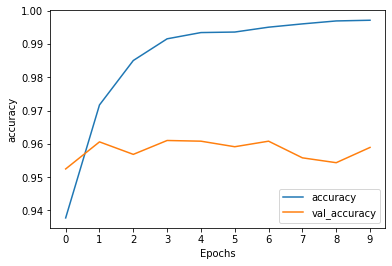

In [74]:
plot_graphs(history, 'accuracy')

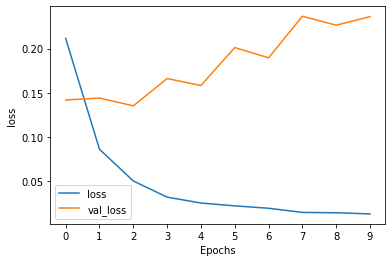

In [75]:
plot_graphs(history, 'loss')

7. The model starts to overfit after a couple of epochs. 
Consider using [early stopping](https://www.tensorflow.org/api_docs/python/tf/keras/callbacks/EarlyStopping) to stop training when a monitored metric has stopped improving. 

  What can we do to tame overfitting?

        Early stopping is a method that allows you to specify an arbitrary large number of training epochs and stop training once the model performance stops improving on a hold out validation dataset. This is a powerful technique that can be used in conjunction with other techniques like tuning the learning rate and tuning the model topology.

        Early stopping is a form of regularization and can be used to prevent overfitting of the training dataset. It is a form of regularization because it adds a constraint to the learning algorithm that limits the capacity of the model. This can be useful when the model is overfitting the training data and cannot be improved by tuning the model topology or tuning the learning rate.

8. Print the classification report of the model on test dataset. 

Bidirectional LSTM

In [76]:
print(classification_report(y_test, (model.predict(X_test) > 0.5).astype("int32")))

250/250 [==============================] - 2s 3ms/step
              precision    recall  f1-score   support

           0       0.97      0.99      0.98      7432
           1       0.75      0.56      0.64       559

    accuracy                           0.96      7991
   macro avg       0.86      0.77      0.81      7991
weighted avg       0.95      0.96      0.95      7991



Non-Bidirectional LSTM

              precision    recall  f1-score   support

           0       0.97      0.97      0.97      7432
           1       0.62      0.64      0.63       559

    accuracy                           0.95      7991
    macro avg      0.80      0.81      0.80      7991
    weighted avg   0.95      0.95      0.95      7991

9. Discuss: how does the BiLSTM model improve the classification over naive Bayes? 

        The BiLSTM model improves the classification over naive Bayes because it is a more complex model. It is able to capture more information from the data and is able to learn more complex relationships between the features and the target variable.

In [77]:
# # NB using tf-idf
#               precision    recall  f1-score   support

#            0       0.96      0.97      0.97      7430
#            1       0.55      0.48      0.51       561

#     accuracy                           0.94      7991
#    macro avg       0.75      0.72      0.74      7991
# weighted avg       0.93      0.94      0.93      7991

# # NB using word2vec
#               precision    recall  f1-score   support

#            0       0.98      0.85      0.91      7430
#            1       0.29      0.82      0.43       561

#     accuracy                           0.85      7991
#    macro avg       0.64      0.83      0.67      7991
# weighted avg       0.94      0.85      0.88      7991

10. Visualize embeddings using [Embedding Projector](https://www.tensorflow.org/tensorboard/tensorboard_projector_plugin) in Tensorboard. 
The setup for Tensorboard can be tricky, most of the code is provided. 

    TensorBoard reads tensors and metadata from the logs of your tensorflow projects. 
    The path to the log directory is specified with log_dir below. 
    
    In order to load the data into Tensorboard, we need to save a training checkpoint to that directory, along with metadata that allows for visualization of a specific layer of interest in the model.

    Load the TensorBoard notebook extension and import `projector` from `tensorboard.plugins`.

In [94]:
%load_ext tensorboard

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


In [95]:
from tensorboard.plugins import projector

11. Clear any logs from previous runs if any.

In [96]:
rm -rf /logs/  

12. Set up a logs directory, so Tensorboard knows where to look for data.

In [97]:
import os
log_dir='/logs/tweets-example/'
if not os.path.exists(log_dir):
    os.makedirs(log_dir)

13. Save the first `VOCAB_SIZE` most frequent words in the vocabulary as `metadata.tsv`.

In [98]:
with open(os.path.join(log_dir, 'metadata.tsv'), "w") as f:
  i = 0
  for label in tokenizer.word_index.keys():
    if label == 'oov':
      continue # skip oov
    f.write("{}\n".format(label))
    if i > VOCAB_SIZE:
      break
    i += 1

14. Save the weights we want to analyze as a variable. Note that the first value represents any unknown word, which is not in the metadata, here we will remove this value.

In [99]:
weights = tf.Variable(model.layers[0].get_weights()[0][1:]) # `embeddings` has a shape of (num_vocab, embedding_dim) 

15. Create a checkpoint from embedding, the filename and key are the name of the tensor.

In [100]:
checkpoint = tf.train.Checkpoint(embedding=weights)
checkpoint.save(os.path.join(log_dir, "embedding.ckpt"))

'/logs/tweets-example/embedding.ckpt-1'

16. Set up config.

In [101]:
config = projector.ProjectorConfig()
embedding = config.embeddings.add()

17. The name of the tensor will be suffixed by `/.ATTRIBUTES/VARIABLE_VALUE`.

In [102]:
embedding.tensor_name = "embedding/.ATTRIBUTES/VARIABLE_VALUE"
embedding.metadata_path = 'metadata.tsv'
projector.visualize_embeddings(log_dir, config)

18. Verify the following files exist under the current directory

In [103]:
ls /logs/tweets-example/

checkpoint                            metadata.tsv
embedding.ckpt-1.data-00000-of-00001  projector_config.pbtxt
embedding.ckpt-1.index


19. Now run Tensorboard against on log data we just saved. 

    You may need to run this cell **twice** to see the projector correctly. 
    Use Chrome for least friction.

In [104]:
%tensorboard --logdir /logs/tweets-example/

Reusing TensorBoard on port 6006 (pid 12808), started 0:06:32 ago. (Use '!kill 12808' to kill it.)

<IPython.core.display.Javascript object>

The TensorBoard Projector can be a great tool for interpreting and visualzing embedding. The dashboard allows users to search for specific terms, and highlights words that are adjacent to each other in the embedding (low-dimensional) space. Try a few word in the Search box and see if the embeddings make sense. 

# Task 6. Interpretation

Lastly let's try to understnad predictions by BiLSTM using a model agnostic approach -- [Local interpretable model-agnostic explanations (LIME)](https://christophm.github.io/interpretable-ml-book/lime.html)

1. Import `LimeTextExplainer` from the [`lime_text`](https://lime-ml.readthedocs.io/en/latest/lime.html#module-lime.lime_text) module in package [`lime`](https://github.com/marcotcr/lime)

In [89]:
from lime.lime_text import LimeTextExplainer

2. Create an instance of `LimeTextExplainer`, call it `explanier`. 

In [90]:
explainer = LimeTextExplainer(class_names=['no', 'yes'], random_state=2)

3. Method `explain_instance` expects the `classifier_fn` to be a function, we provide the function `predict_proba` as below. 

In [91]:
def predict_proba(arr):
    processed = tokenizer.texts_to_sequences(arr)
    processed = pad_sequences(processed, padding='post', maxlen=MAX_LEN)
    pred = model.predict(processed)
    r = []
    for i in pred:
        temp = i[0]
        r.append(np.array([1-temp,temp])) 
    return np.array(r)

4. Read about [`explain_instance`](https://lime-ml.readthedocs.io/en/latest/lime.html#lime.lime_text.LimeTextExplainer.explain_instance). 

    Create an instance named `exp` to explain the 16399th tidy tweet from the original dataset, i.e., `raw.tidy_tweet.iloc[16399]`. 

In [92]:
idx = 16399 
exp = explainer.explain_instance(
    raw.tidy_tweet.iloc[idx], predict_proba,
    num_features=6)
exp.show_in_notebook(text=raw.tidy_tweet.iloc[idx])

157/157 [==============================] - 1s 5ms/step


5. Pick another random tweet and generate explanations for the prediction.

In [93]:
idx = 6969 
exp = explainer.explain_instance(
    raw.tidy_tweet.iloc[idx], predict_proba,
    num_features=6)
exp.show_in_notebook(text=raw.tidy_tweet.iloc[idx])

157/157 [==============================] - 1s 3ms/step


6. Jot down your observations in explaining the model. 

        The explainer does a good job of showing which were the most influencial features for making a prediction. It also shows the direction of the influence, whether it was positive or negative. The explainer also shows the probability of the prediction. The confidence each way (0.01 or 0.99) seem to polar.

### Week 10 Assignment Questions

How does the Naive Bayes Classifier work?
What is Posterior Probability?

        The Naive Bayes Classifier works by calculating the probability of a given class given the features. It does this by calculating the probability of each feature given the class, and then multiplying them together. It then normalizes the probabilities by dividing by the sum of the probabilities. The class with the highest probability is the predicted class.

        Posterior probability is the probability of a class given the features. It is calculated by multiplying the prior probability of the class by the likelihood of the features given the class, and then dividing by the likelihood of the features.

What is the difference between stemming and lemmatization in NLP?

        Stemming and lemmatization are both techniques used to reduce words to their root form. Stemming is a rule-based process that chops off the ends of words in the hope of achieving this goal correctly most of the time, and often includes the removal of derivational affixes. Lemmatization is a more sophisticated process that takes into account morphological analysis of the words. It is able to achieve this goal correctly most of the time, and often includes the removal of inflectional endings only.

What is Word2Vec and how does it work?

        Word2Vec is a model that learns word embeddings by predicting the context of a word given a set of words. It does this by training a neural network to predict the context of a word given a set of words. The context of a word is defined as the words that appear before and after it in a document. The model learns the embedding by minimizing the error between the predicted context and the actual context.

When to use GRU over LSTM?

        GRU is a simpler version of LSTM. It is simpler because it has fewer parameters than LSTM. It is also simpler because it does not have a cell state. GRU is a good choice when you want to use a simpler model that is less computationally expensive to train.

# Acknowledgement & Reference

- Data is adapted from [Twitter sentiment analysis](https://datahack.analyticsvidhya.com/contest/practice-problem-twitter-sentiment-analysis/#ProblemStatement)
- [Twitter sentiment analysis](https://github.com/prateekjoshi565/twitter_sentiment_analysis/blob/master/code_sentiment_analysis.ipynb) 
- [Introduction to Word Embedding and Word2Vec](https://towardsdatascience.com/introduction-to-word-embedding-and-word2vec-652d0c2060fa)
- [When to use GRU over LSTM?](https://datascience.stackexchange.com/questions/14581/when-to-use-gru-over-lstm)
- Use a trained Word2Vec, Doc2Vec or FastTest embedding by `gensim` in buiding an embedding layers in Tensorflow, here's [how-to](https://github.com/RaRe-Technologies/gensim/wiki/Using-Gensim-Embeddings-with-Keras-and-Tensorflow).